In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
import cv2
import math
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

In [ ]:
#Single Image Haze Removal Using Dark Channel Prior
#Implemented by Zhang He (https://github.com/He-Zhang/image_dehaze) 

#Obtain Dark Channel Prior of an Image
def DarkChannel(im,sz=15):
    b,g,r = cv2.split(im)
    dc = cv2.min(cv2.min(r,g),b);
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT,(sz,sz))
    dark = cv2.erode(dc,kernel)
    return dark

#Estimate Atmospheric Light from an Image
def AtmLight(im,dark):
    [h,w] = im.shape[:2]
    imsz = h*w
    numpx = int(max(math.floor(imsz/1000),1))
    darkvec = dark.reshape(imsz);
    imvec = im.reshape(imsz,3);

    indices = darkvec.argsort();
    indices = indices[imsz-numpx::]

    atmsum = np.zeros([1,3])
    for ind in range(1,numpx):
       atmsum = atmsum + imvec[indices[ind]]

    A = atmsum / numpx;
    return A

#Estimate Transmission of an Image
def TransmissionEstimate(im,A,sz):
    omega = 0.95;
    im3 = np.empty(im.shape,im.dtype);

    for ind in range(0,3):
        im3[:,:,ind] = im[:,:,ind]/A[0,ind]

    transmission = 1 - omega*DarkChannel(im3,sz);
    return transmission

#Guided Filter Used to Refine The Previously Estimated Transmission
def Guidedfilter(im,p,r,eps):
    mean_I = cv2.boxFilter(im,cv2.CV_64F,(r,r));
    mean_p = cv2.boxFilter(p, cv2.CV_64F,(r,r));
    mean_Ip = cv2.boxFilter(im*p,cv2.CV_64F,(r,r));
    cov_Ip = mean_Ip - mean_I*mean_p;

    mean_II = cv2.boxFilter(im*im,cv2.CV_64F,(r,r));
    var_I   = mean_II - mean_I*mean_I;

    a = cov_Ip/(var_I + eps);
    b = mean_p - a*mean_I;

    mean_a = cv2.boxFilter(a,cv2.CV_64F,(r,r));
    mean_b = cv2.boxFilter(b,cv2.CV_64F,(r,r));

    q = mean_a*im + mean_b;
    return q;

#Refine Transmission Using Guided Filter
def TransmissionRefine(im,et):
    gray = cv2.cvtColor(im,cv2.COLOR_BGR2GRAY);
    gray = np.float64(gray)/255;
    r = 60;
    eps = 0.0001;
    t = Guidedfilter(gray,et,r,eps);

    return t;

#Recover Scene Radiance of an Image (The Unhazed Image)
def Recover(im,t,A,tx = 0.1):
    res = np.empty(im.shape,im.dtype);
    t = cv2.max(t,tx);

    for ind in range(0,3):
        res[:,:,ind] = (im[:,:,ind]-A[0,ind])/t + A[0,ind]

    return res

In [ ]:
#O-haze Dataset Directory

dir_gt    = '/content/drive/MyDrive/ohaze/ground_truth/'
dir_hazy  = '/content/drive/MyDrive/ohaze/hazy_images/'

list_gt   = os.listdir(dir_gt)
list_hazy = os.listdir(dir_hazy)
list_gt.sort()
list_hazy.sort()

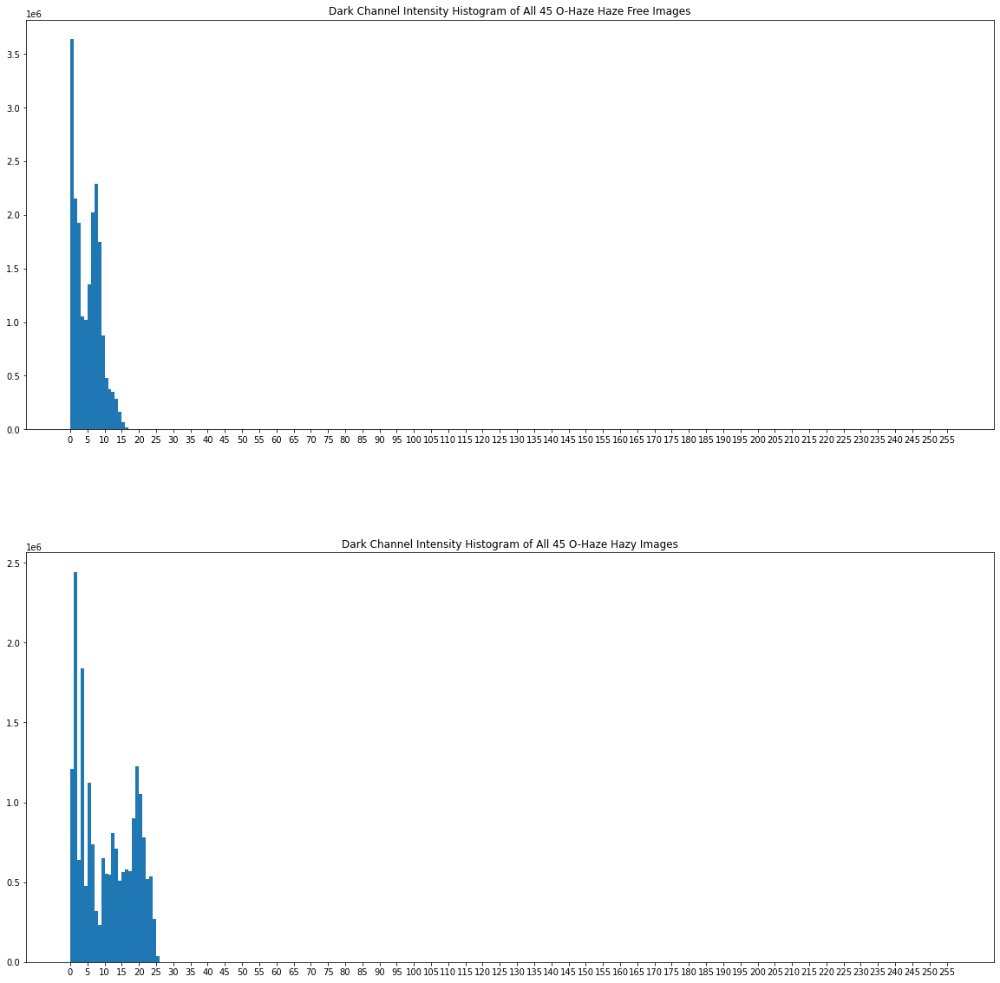

In [ ]:
#Proving Dark Channel Prior's Correctness

cum_hazy_intensity = np.array(0)
cum_gt_intensity = np.array(0)

#Magic_Add to Add Two Numpy Array with Different Dimensions
def magic_add(*args):
    n = max(a.ndim for a in args)
    args = [a.reshape((n - a.ndim)*(1,) + a.shape) for a in args]
    shape = np.max([a.shape for a in args], 0)
    result = np.zeros(shape)

    for a in args:
        idx = tuple(slice(i) for i in a.shape)
        result[idx] += a
    return result

#Sum All O-Haze Images' Dark Channel
for i in range(1, 46):
  hazy_img = cv2.imread(dir_hazy + list_hazy[i - 1]);
  gt_img  = cv2.cvtColor(cv2.imread(dir_gt + list_gt[i - 1]), cv2.COLOR_BGR2RGB);

  I = hazy_img.astype('float64')/255;
  dark = DarkChannel(I,15);
  I2 = gt_img.astype('float64')/255;
  dark2 = DarkChannel(I2,15);

  cum_hazy_intensity = magic_add(cum_hazy_intensity, dark.flatten())
  cum_gt_intensity = magic_add(cum_gt_intensity, dark2.flatten())

#Plot The Dark Channel Histograms
plt.figure(figsize=(20,20))
plt.subplot(2,1,1)
plt.xticks([i for i in range(0,260,5)])
plt.hist(cum_gt_intensity, 256, range=(0,256))
plt.title('Dark Channel Intensity Histogram of All 45 O-Haze Haze Free Images')
plt.subplot(2,1,2)
plt.xticks([i for i in range(0,260, 5)])
plt.hist(cum_hazy_intensity, 256, range=(0,256))
plt.title('Dark Channel Intensity Histogram of All 45 O-Haze Hazy Images')
plt.subplots_adjust(hspace=0.3)
plt.show()

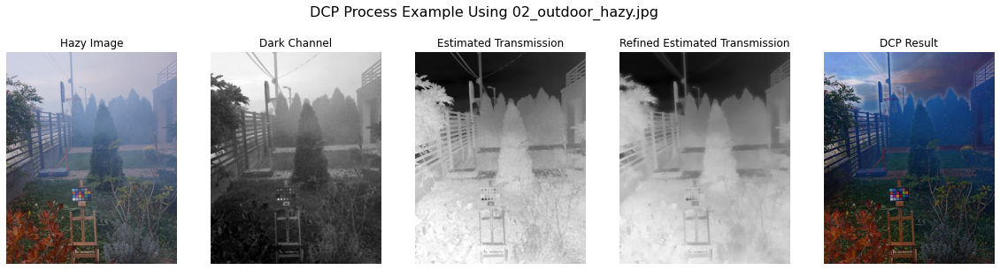

In [ ]:
#Show How DCP Works

#Use 02_outdoor_hazy.jpg to Test DCP
test_img = cv2.imread('/content/drive/MyDrive/ohaze/hazy_images/02_outdoor_hazy.jpg')

#Get Intensity, Dark Channel, Atmospheric Light, Estimated Transmission,
#Refined Estimated Transmission, and Recovered Haze Free Image of
#02_outdoor_hazy.jpg
I = test_img.astype('float64')/255;
dark = DarkChannel(I,15);
A = AtmLight(I,dark);
te = TransmissionEstimate(I,A,15);
t = TransmissionRefine(test_img,te);
J = Recover(I,t,A,0.1);

#Show The DCP Process
plt.figure(figsize=(20,5))
plt.suptitle("DCP Process Example Using 02_outdoor_hazy.jpg", fontsize=16)
plt.subplot(151); plt.title('Hazy Image')
plt.imshow(cv2.cvtColor(test_img, cv2.COLOR_BGR2RGB), cmap='gray'); plt.axis('off')
plt.subplot(152); plt.title('Dark Channel')
plt.imshow(dark, cmap='gray'); plt.axis('off')
plt.subplot(153); plt.title('Estimated Transmission')
plt.imshow(te, cmap='gray'); plt.axis('off')
plt.subplot(154); plt.title('Refined Estimated Transmission')
plt.imshow(t, cmap='gray'); plt.axis('off')
plt.subplot(155); plt.title('DCP Result')
plt.imshow(cv2.cvtColor((J * 255).astype('uint8'), cv2.COLOR_BGR2RGB), cmap='gray'); plt.axis('off')
plt.show()

In [ ]:
def _ssim(img1, img2, window, window_size, channel, size_average=True):
    mu1 = F.conv2d(img1, window, padding=window_size // 2, groups=channel)
    mu2 = F.conv2d(img2, window, padding=window_size // 2, groups=channel)
    mu1_sq = mu1.pow(2)
    mu2_sq = mu2.pow(2)
    mu1_mu2 = mu1 * mu2
    sigma1_sq = F.conv2d(img1 * img1, window, padding=window_size // 2, groups=channel) - mu1_sq
    sigma2_sq = F.conv2d(img2 * img2, window, padding=window_size // 2, groups=channel) - mu2_sq
    sigma12 = F.conv2d(img1 * img2, window, padding=window_size // 2, groups=channel) - mu1_mu2
    C1 = 0.01 ** 2
    C2 = 0.03 ** 2
    ssim_map = ((2 * mu1_mu2 + C1) * (2 * sigma12 + C2)) / ((mu1_sq + mu2_sq + C1) * (sigma1_sq + sigma2_sq + C2))

    if size_average:
        return ssim_map.mean()
    else:
        return ssim_map.mean(1).mean(1).mean(1)


def ssim(img1, img2, window_size=11, size_average=True):
    img1=torch.clamp(img1,min=0,max=1)
    img2=torch.clamp(img2,min=0,max=1)
    (_, channel, _, _) = img1.size()
    window = create_window(window_size, channel)
    if img1.is_cuda:
        window = window.cuda(img1.get_device())
    window = window.type_as(img1)
    return _ssim(img1, img2, window, window_size, channel, size_average)



---



In [ ]:
#Apply DCP to 45 Images From O-haze Dataset

import time
from skimage.metrics import structural_similarity as ssim

#Show DCP Result and Return SSIM Score and Runtime
def comparison(n):
  src_img = cv2.imread(dir_hazy + list_hazy[n - 1]);
  gt_img  = cv2.cvtColor(cv2.imread(dir_gt + list_gt[n - 1]), cv2.COLOR_BGR2RGB);

  start = time.time()

  I = src_img.astype('float64')/255;
  dark = DarkChannel(I,15);
  A = AtmLight(I,dark);
  te = TransmissionEstimate(I,A,15);
  t = TransmissionRefine(src_img,te);
  J = Recover(I,t,A,0.1);

  end = time.time()

  plt.figure(figsize=(20,5))
  plt.suptitle(list_hazy[n - 1], fontsize=16)
  plt.subplot(131); plt.title('Hazy Image')
  plt.imshow(cv2.cvtColor(src_img, cv2.COLOR_BGR2RGB)); plt.axis('off')
  plt.subplot(132); plt.title('Dehazed Image')
  plt.imshow(cv2.cvtColor((J * 255).astype('uint8'), cv2.COLOR_BGR2RGB)); plt.axis('off')
  plt.subplot(133); plt.title('Ground Truth')
  plt.imshow(gt_img); plt.axis('off')
  plt.show()

  return ssim(J * 255, gt_img, multichannel=True), end-start

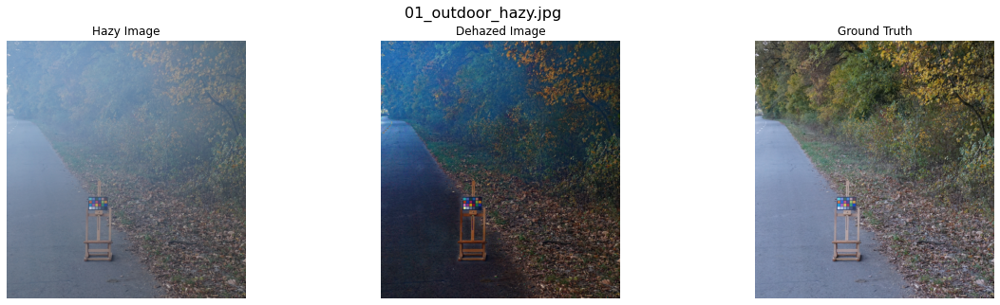

/usr/local/lib/python3.7/dist-packages/skimage/metrics/_structural_similarity.py:108: UserWarning: Inputs have mismatched dtype.  Setting data_range based on im1.dtype.
  im2[..., ch], **args)


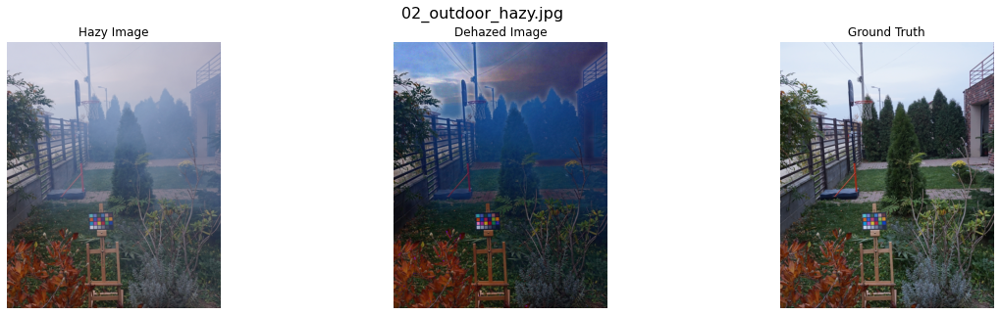

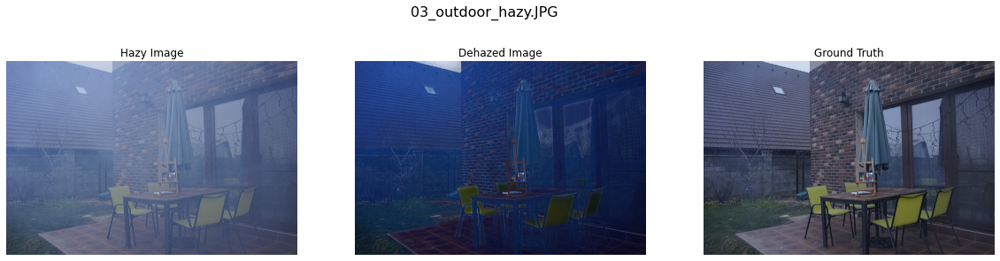

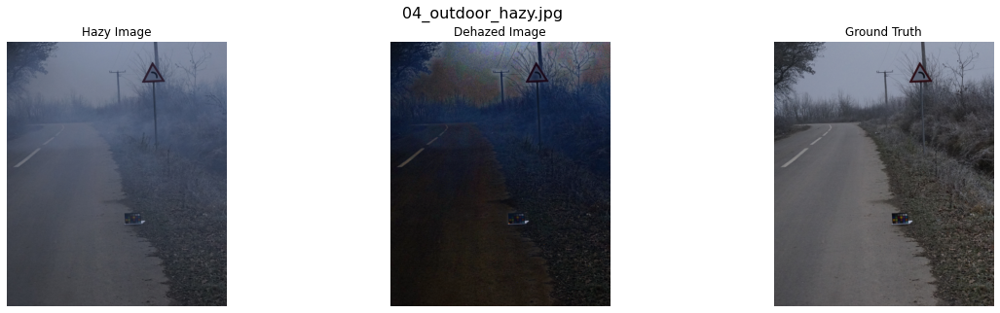

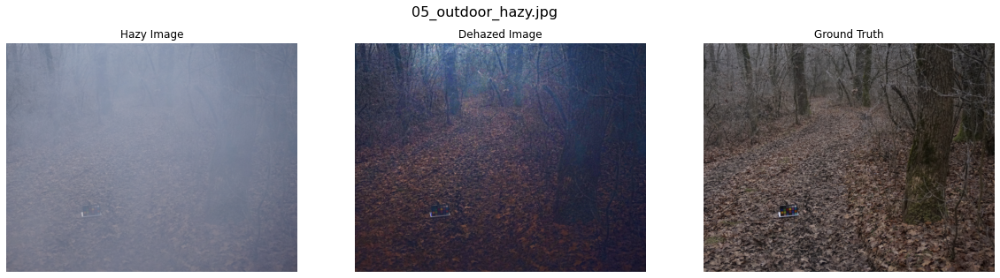

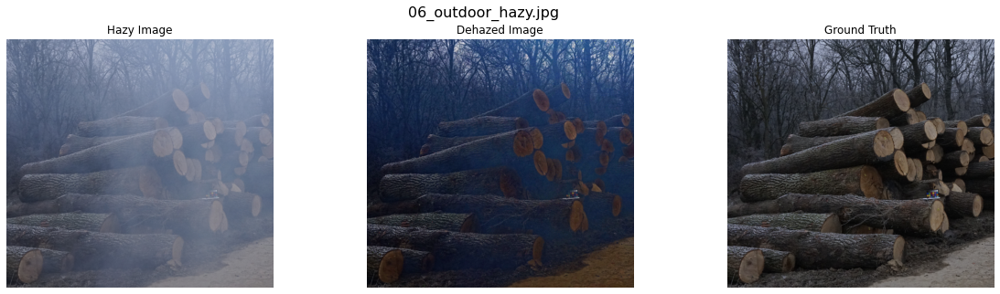

...

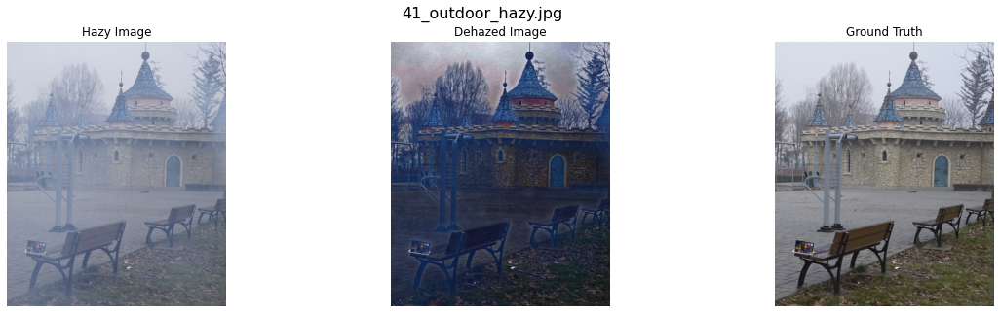

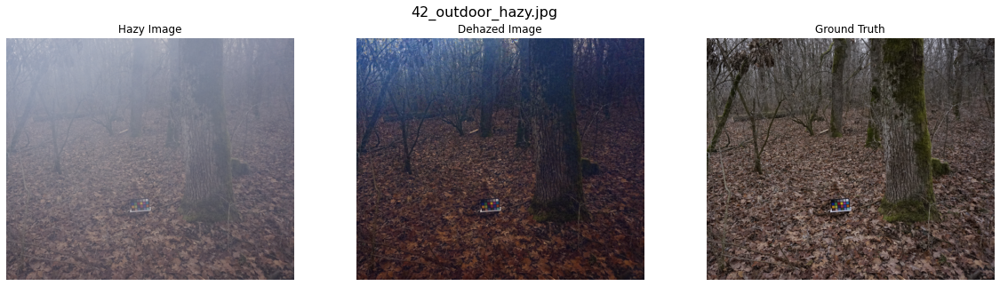

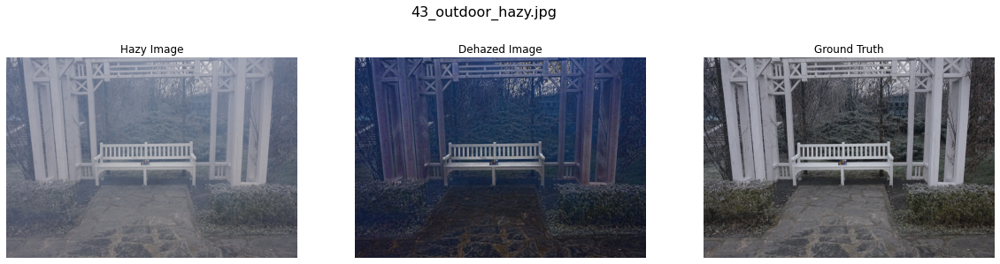

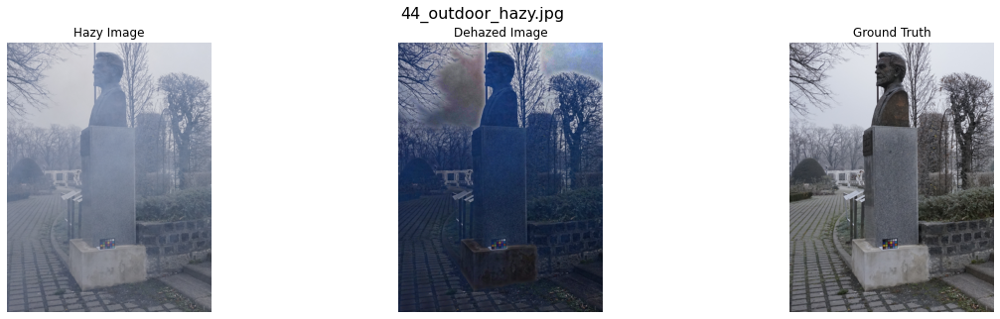

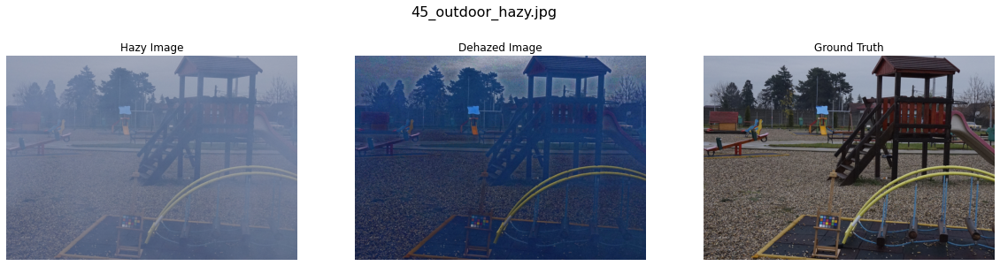

In [ ]:
#Show the Results and Collect SSIM Score and Runtime

ssim_list = []
time_list = []

for i in range(1, 46):
  ssim_score, time_needed = comparison(i)

  ssim_list.append(ssim_score)
  time_list.append(time_needed)

  print('\n')

SSIM Result for 1_outdoor_hazy.jpg: 0.3857455704333259
SSIM Result for 2_outdoor_hazy.jpg: 0.28542243851078
SSIM Result for 3_outdoor_hazy.jpg: 0.18706630261581425
SSIM Result for 4_outdoor_hazy.jpg: 0.1400821265853326
SSIM Result for 5_outdoor_hazy.jpg: 0.24935303534040676
SSIM Result for 6_outdoor_hazy.jpg: 0.29381373367394775
SSIM Result for 7_outdoor_hazy.jpg: 0.3446916684247465
SSIM Result for 8_outdoor_hazy.jpg: 0.24701994261190027
SSIM Result for 9_outdoor_hazy.jpg: 0.2737740338959623
SSIM Result for 10_outdoor_hazy.jpg: 0.3677486986430408
SSIM Result for 11_outdoor_hazy.jpg: 0.3412828513589827
SSIM Result for 12_outdoor_hazy.jpg: 0.4444064590209709
SSIM Result for 13_outdoor_hazy.jpg: 0.3119228239982039
SSIM Result for 14_outdoor_hazy.jpg: 0.2875472187184727
SSIM Result for 15_outdoor_hazy.jpg: 0.1625688017528307
SSIM Result for 16_outdoor_hazy.jpg: 0.16123147617675268
SSIM Result for 17_outdoor_hazy.jpg: 0.23496151250496322
SSIM Result for 18_outdoor_hazy.jpg: 0.35871631310822

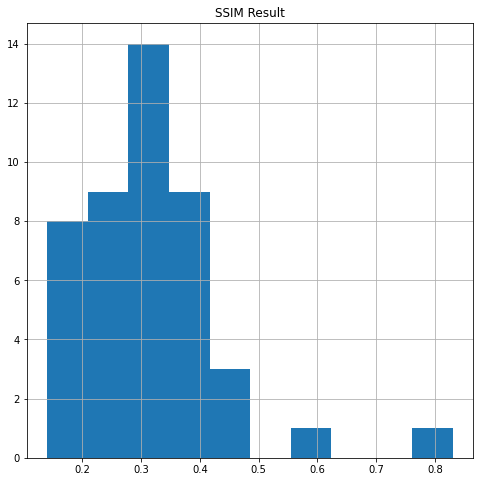

,SSIM Result
count,45.000000
mean,0.313094
std,0.121775
min,0.140082
25%,0.234962
50%,0.311923
75%,0.358716
max,0.830823


In [ ]:
#Show SSIM Result 
for i in range(1,len(ssim_list)+1):
  print(f"SSIM Result for {i}_outdoor_hazy.jpg: {ssim_list[i-1]}")

ssim_df = pd.DataFrame(data = ssim_list, columns=['SSIM Result'])

fig = plt.figure(figsize = (8,8))
ax = fig.gca()
ssim_df.hist(ax=ax)
plt.show()

print()
display(ssim_df.describe())

DCP Runtime for 0_outdoor_hazy.jpg: 2.631117343902588 seconds
DCP Runtime for 1_outdoor_hazy.jpg: 1.9493787288665771 seconds
DCP Runtime for 2_outdoor_hazy.jpg: 4.947740077972412 seconds
DCP Runtime for 3_outdoor_hazy.jpg: 2.396275758743286 seconds
DCP Runtime for 4_outdoor_hazy.jpg: 4.224925518035889 seconds
DCP Runtime for 5_outdoor_hazy.jpg: 2.533060073852539 seconds
DCP Runtime for 6_outdoor_hazy.jpg: 3.7520647048950195 seconds
DCP Runtime for 7_outdoor_hazy.jpg: 2.207634925842285 seconds
DCP Runtime for 8_outdoor_hazy.jpg: 1.7180562019348145 seconds
DCP Runtime for 9_outdoor_hazy.jpg: 1.5764143466949463 seconds
DCP Runtime for 10_outdoor_hazy.jpg: 2.4592373371124268 seconds
DCP Runtime for 11_outdoor_hazy.jpg: 2.8742496967315674 seconds
DCP Runtime for 12_outdoor_hazy.jpg: 2.802715539932251 seconds
DCP Runtime for 13_outdoor_hazy.jpg: 4.065438747406006 seconds
DCP Runtime for 14_outdoor_hazy.jpg: 2.969683885574341 seconds
DCP Runtime for 15_outdoor_hazy.jpg: 3.388270139694214 seco

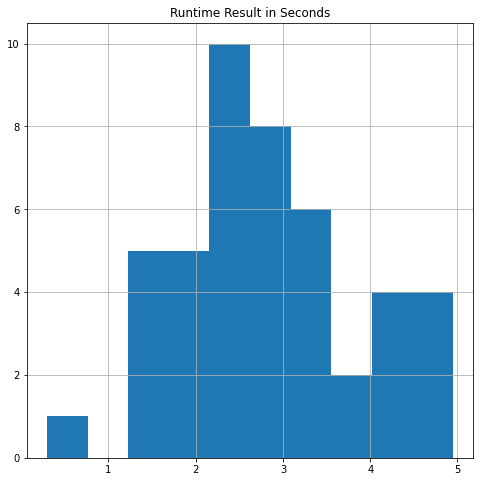

,Runtime Result in Seconds
count,45.000000
mean,2.825397
std,1.056962
min,0.298841
25%,2.207635
50%,2.665689
75%,3.405123
max,4.947740


In [ ]:
#Show Runtime Result
for i in range(len(time_list)):
  print(f"DCP Runtime for {i}_outdoor_hazy.jpg: {time_list[i]} seconds")

time_df = pd.DataFrame(data = time_list, columns=['Runtime Result in Seconds'])

fig = plt.figure(figsize = (8,8))
ax = fig.gca()
time_df.hist(ax=ax)
plt.show()

print()
display(time_df.describe())